# Dog Breed Identification using Transfer Learning and TensorFlow 2.

## Inspiration
You might not be a dog person, so you might not know a lot of dog breeds, but you are a human and you will definately at some point look at a dog and feel aww that is a real nice dog. I wonder what breed it is?

In this project we're going to be using machine learning to help us identify different breeds of dogs.

To do this, we'll be using data from one of the competition, [Dog breed identification competition](https://www.kaggle.com/c/dog-breed-identification/overview) on kaggle. It consists of a collection of 10,000+ labelled images of 120 different dog breeds.

This is a multi-class image classification as we're trying to classify mutliple different breeds of dog.



## Workflow


We're going to go through the following workflow:
1. Get data ready.
2. Prepare the data.
3. Choose and fit/train a model.
4. Evaluating a model (making predictions, comparing them with the ground truth labels).
5. Saving and reloading your model.
6. Test on on the test Data.
7. Using custom Images


## 1. Get data ready

*Unziping dataset in drive*

In [99]:
#!unzip "drive/MyDrive/DBI Project/dog-breed-identification.zip" -d "/content/drive/MyDrive/DBI Project/"

*Importing necessary libraries*

In [100]:
import tensorflow as tf
print("TF Ver:", tf.__version__)

TF Ver: 2.8.2


In [101]:
import tensorflow_hub as hub
import pandas as pd

*Checking labels of our data*

In [102]:
labels_csv = pd.read_csv("/content/drive/MyDrive/DBI Project/labels.csv")

In [103]:
print(labels_csv.describe())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126


In [104]:
print(labels_csv.head())

                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


In [105]:
labels_csv["breed"].value_counts()

scottish_deerhound      126
maltese_dog             117
afghan_hound            116
entlebucher             115
bernese_mountain_dog    114
                       ... 
golden_retriever         67
brabancon_griffon        67
komondor                 67
eskimo_dog               66
briard                   66
Name: breed, Length: 120, dtype: int64

*Displaying image from our train dataset*

In [106]:
from IPython.display import Image

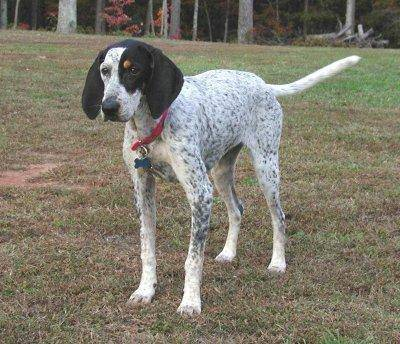

In [107]:
Image("/content/drive/MyDrive/DBI Project/train/00214f311d5d2247d5dfe4fe24b2303d.jpg")

*Creating a list of all images*

In [108]:
filenames = ["/content/drive/MyDrive/DBI Project/train/" + fname + ".jpg" for fname in labels_csv["id"]]

In [109]:
filenames[:10]

['/content/drive/MyDrive/DBI Project/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/DBI Project/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/DBI Project/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/DBI Project/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/DBI Project/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 '/content/drive/MyDrive/DBI Project/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 '/content/drive/MyDrive/DBI Project/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 '/content/drive/MyDrive/DBI Project/train/002a283a315af96eaea0e28e7163b21b.jpg',
 '/content/drive/MyDrive/DBI Project/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 '/content/drive/MyDrive/DBI Project/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

*Checking if number of items in list is equal to number of images in train folder*

In [110]:
import os
if len(os.listdir("/content/drive/MyDrive/DBI Project/train/")) == len(filenames):
  print("Filenames match actual amount of files!")
else:
  print("Filenames do not match actual amount of files.")

Filenames match actual amount of files!


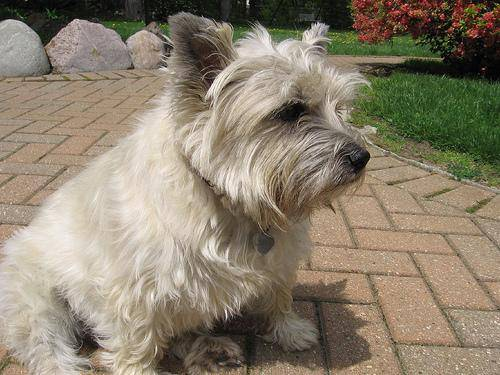

In [111]:
Image(filenames[29])

*Converting labels in csv file to numpy array*

In [112]:
import numpy as np
labels = labels_csv["breed"].to_numpy()
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

*Checking if labels are in same quantity as in csv file*

In [113]:
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames.")

Number of labels matches number of filenames!


*Finding unique breeds*

In [114]:
unique_breeds = np.unique(labels)
len(unique_breeds)


120

*Checking for Boston Bull in unique breeds array when we find it, return true.*





In [115]:
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

*Doing same thing done above for every label.*

In [116]:
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

## 2. Prepare the data

*Making validation set*

In [117]:
X = filenames
y = boolean_labels

In [118]:
NUM_IMAGES = 1000
NUM_IMAGES

1000

*Splitting our data into train test. Currently only taking 1000 samples.*

In [119]:
from sklearn.model_selection import train_test_split


X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES], 
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [120]:
X_train[:2]

['/content/drive/MyDrive/DBI Project/train/00bee065dcec471f26394855c5c2f3de.jpg',
 '/content/drive/MyDrive/DBI Project/train/0d2f9e12a2611d911d91a339074c8154.jpg']

In [121]:
y_train[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False,  True,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal



###Preprocessing images


1.   Takes an image filename as input.
2.   Uses TensorFlow to read the file and save it to a variable, image.
3.   Turn our image (a jpeg file) into Tensors.
4.   Normalise our image(between 0-1).
5.   Resize the image to be of shape (224, 224).
6.  Return the modified image.



In [122]:
from matplotlib.pyplot import imread
image = imread(filenames[42]) # read in an image
image.shape
#gives image properties like height, width colour channel

(257, 350, 3)

*Converting image into tensor*

In [123]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

In [124]:
# fixing image size
IMG_SIZE = 224

*Creating a function to convert image to tensor*

In [125]:
# used for test dataset
def process_image(image_path):

  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels 
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the colour channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 244)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

### Creating a Mini batch

*function to return a tuple (tensor and label)*

In [126]:
# used for train and val dataset
def get_image_label(image_path, label):
  image = process_image(image_path)
  return image, label

*Create a function to turn data into batches*

In [127]:
BATCH_SIZE = 32

def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):

  # If the data is a test dataset, we don't have labels
  if test_data:
    print("Creating test data batches...")
    # Turn filepaths into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    # Turn the data into batches
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  
  # If the data if a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
     # Turn the data into batches                                          
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # In case of training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                              tf.constant(y))) # labels
    
    data = data.shuffle(buffer_size=len(x))

    # Turn the data into batches
    data_batch =data.map(get_image_label).batch(BATCH_SIZE)
  return data_batch

In [128]:
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [129]:
train_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))

In [130]:
val_data.element_spec

(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
 TensorSpec(shape=(None, 120), dtype=tf.bool, name=None))

### Visualising Data Batches

*Create a function for viewing images in a data batch*

In [131]:
import matplotlib.pyplot as plt


def show_25_images(images, labels):
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn gird lines off
    plt.axis("off")

*Visualize training images from the training data batch*

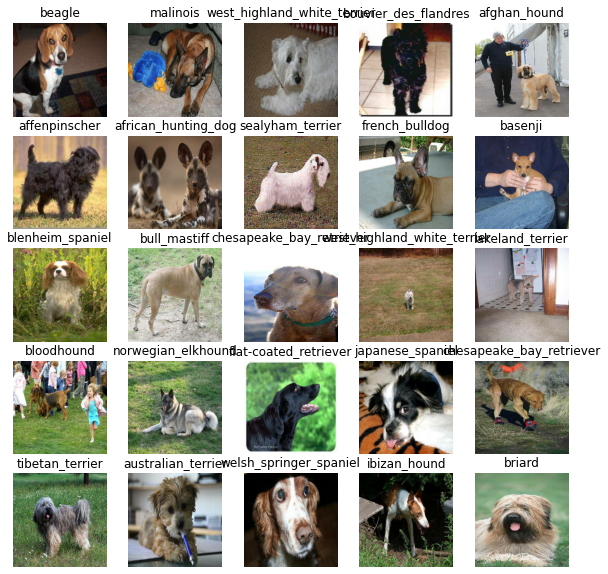

In [132]:
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

*Visualize validation images from the validation data batch*

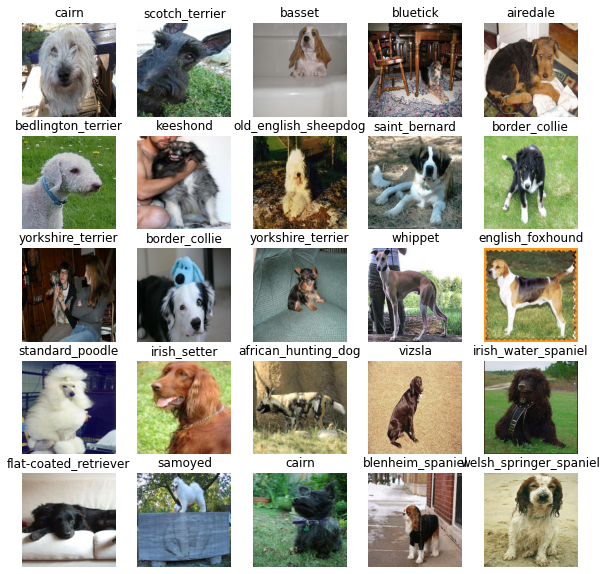

In [133]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

## 3. Building a model

We'll use an existing model from TensorFlow Hub.

Since we know our problem is image classification (classifying different dog breeds), we start by choosing the image problem domain, and then can filter it down by subdomains, in our case, image classification.

Doing this gives a list of different pretrained models we can apply to our task.

We found [mobilenet_v2_130_224](https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4) model to be suitable for our needs, this model takes an input of images in the shape 224, 224 and also the model has been trained in the domain of image classification.


In [134]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

*Building a keras model. The process to build is encoded in a function.*

In [135]:
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):

  # Setup the model layers
  model = tf.keras.Sequential([
    hub.KerasLayer(MODEL_URL), # Layer 1 (input layer and hidden layers)
    tf.keras.layers.Dense(units=OUTPUT_SHAPE, 
                          activation="softmax") # Layer 2 (output layer)
  ])

  # Compile the model
  model.compile(
      loss=tf.keras.losses.CategoricalCrossentropy(),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=["accuracy"]
  )

  # Build the model
  model.build(INPUT_SHAPE)
  
  return model

In [136]:
# Create a model and check its details
model = create_model()
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer_1 (KerasLayer)  (None, 1001)              5432713   
                                                                 
 dense_1 (Dense)             (None, 120)               120240    
                                                                 
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


### Creating a callback

Used to save model progress, check progress, stop training early if model stoped improving.

 ### TensorBoard callback

TensorBoard helps provide a visual way to monitor the progress of your model during and after training.

It can be used directly in a notebook to track the performance measures of a model such as loss and accuracy.

In [137]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [138]:
import datetime

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("/content/drive/MyDrive/DBI Project/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf.keras.callbacks.TensorBoard(logdir)

### Early stopping callback

Early stopping helps prevent overfitting by stopping a model when a certain evaluation metric stops improving.

In [139]:
# once our model stops improving, stop training
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of no improvements

### Training a Model(1000 samples only)

NUM_EPOCHS defines how many passes of the data we'd like our model to do. A pass is equivalent to our model trying to find patterns in each dog image and see which patterns relate to each label.

If NUM_EPOCHS=1, the model will only look at the data once and will probably score badly because it hasn't a chance to correct itself.

In [140]:
NUM_EPOCHS = 100

*Function to train a model*

In [141]:
def train_model():
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, # check validation metrics every epoch
            callbacks=[tensorboard, early_stopping])
  
  return model

In [142]:
model = train_model()

Epoch 1/100
25/25 [==============================] - 151s 6s/step - loss: 4.7654 - accuracy: 0.1025 - val_loss: 3.5062 - val_accuracy: 0.2400
Epoch 2/100
25/25 [==============================] - 3s 124ms/step - loss: 1.7506 - accuracy: 0.6575 - val_loss: 2.2078 - val_accuracy: 0.4950
Epoch 3/100
25/25 [==============================] - 4s 154ms/step - loss: 0.5967 - accuracy: 0.9350 - val_loss: 1.7655 - val_accuracy: 0.5900
Epoch 4/100
25/25 [==============================] - 4s 160ms/step - loss: 0.2640 - accuracy: 0.9875 - val_loss: 1.5291 - val_accuracy: 0.6150
Epoch 5/100
25/25 [==============================] - 3s 134ms/step - loss: 0.1515 - accuracy: 0.9962 - val_loss: 1.4571 - val_accuracy: 0.6200
Epoch 6/100
25/25 [==============================] - 4s 162ms/step - loss: 0.1057 - accuracy: 1.0000 - val_loss: 1.4180 - val_accuracy: 0.6300
Epoch 7/100
25/25 [==============================] - 3s 137ms/step - loss: 0.0781 - accuracy: 1.0000 - val_loss: 1.3819 - val_accuracy: 0.6350


In [143]:
%tensorboard --logdir "/content/drive/MyDrive/DBI Project/logs"

<IPython.core.display.Javascript object>

## 4. Evaluating a model

###Making Predictions

*Now since our model is trained we will try to predict the label on validation data.*

In [144]:
predictions = model.predict(val_data, verbose=1) # verbose shows us how long there is to go
predictions

7/7 [==============================] - 3s 107ms/step


array([[4.9515627e-03, 2.2631475e-05, 4.4326932e-04, ..., 5.5136043e-04,
        4.4284130e-05, 2.3751752e-03],
       [4.0426659e-03, 7.7446783e-04, 1.5808448e-02, ..., 6.2876008e-04,
        1.5680793e-03, 4.8641890e-04],
       [4.9049841e-06, 9.6490903e-06, 5.0216900e-06, ..., 4.9731996e-05,
        1.7640983e-05, 9.3605857e-05],
       ...,
       [3.4729423e-05, 1.7766148e-04, 1.4650289e-04, ..., 1.5386497e-04,
        2.3098924e-04, 4.0180073e-04],
       [1.2744265e-02, 1.6829265e-04, 2.4737371e-04, ..., 8.2797679e-04,
        7.3955845e-05, 1.7131461e-02],
       [9.5029449e-05, 8.9329169e-06, 3.7558987e-03, ..., 4.9298303e-03,
        6.5767404e-04, 2.5409370e-04]], dtype=float32)

In [145]:
predictions.shape

(200, 120)

In [146]:
# First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[4.95156273e-03 2.26314751e-05 4.43269324e-04 6.87097854e-05
 2.92626122e-04 5.95923957e-05 1.84792988e-02 7.88736506e-05
 3.67656321e-05 6.42707921e-04 1.92482054e-04 3.94787843e-04
 7.75005377e-04 3.23696840e-05 5.32048231e-04 4.28266649e-04
 1.30198256e-04 4.27531362e-01 1.75385649e-04 1.01010221e-04
 3.27046000e-04 4.57374437e-04 4.72344400e-05 4.67187259e-04
 1.22316836e-04 1.88637088e-04 4.63308431e-02 1.27040519e-04
 5.36319858e-04 1.17128329e-04 8.33522354e-05 1.42407254e-03
 3.98822740e-04 1.81429441e-05 2.17423323e-04 5.75046008e-03
 1.61742482e-05 2.08851619e-04 1.38519084e-04 1.42022676e-04
 2.31429818e-03 2.44681960e-05 6.87896681e-04 2.95996579e-04
 7.87906538e-05 1.21897370e-04 1.60685944e-04 2.89637155e-05
 7.51166372e-04 3.97683500e-04 8.32815203e-05 1.13631679e-04
 1.30755163e-03 2.64688933e-05 1.94338339e-04 4.36418668e-05
 2.20503367e-04 4.66591725e-03 1.09992176e-03 1.18148744e-01
 6.22630410e-04 1.74973495e-04 3.09937255e-04 3.28536335e-05
 1.73956156e-03 6.924142

*Turn prediction probabilities into their respective label (easier to understand)*

In [147]:
def get_pred_label(prediction_probabilities):

  return unique_breeds[np.argmax(prediction_probabilities)]


In [148]:
# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[42])
pred_label

'walker_hound'

Since our validation data (val_data) is in batch form, to get a list of validation images and labels, we'll have to unbatch it (using unbatch()) and then turn it into an iterator using as_numpy_iterator().

*Create a function to unbatch a batched dataset*

In [149]:
def unbatchify(data):
  images = []
  labels = []
  # Loop through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

In [150]:
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.2770141 , 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

*Function for predicted label, true label and image*

In [151]:
def plot_pred(prediction_probabilities, labels, images, n=2):

  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]
  
  # Get the pred label
  pred_label = get_pred_label(pred_prob)
  
  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                      np.max(pred_prob)*100,
                                      true_label),
                                      color=color)

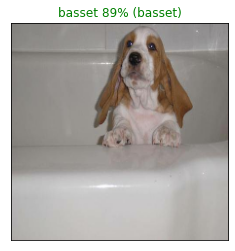

In [152]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. 

Let's build a function to demonstrate

In [153]:
def plot_pred_conf(prediction_probabilities, labels, n=2):

  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)), 
                     top_10_pred_values, 
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

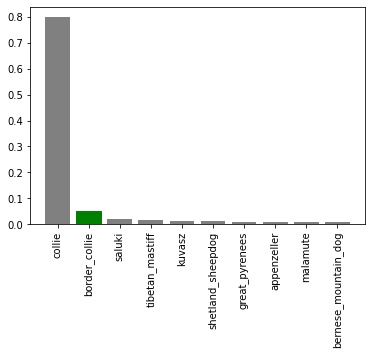

In [154]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

*Let's check a few predictions and their different values*

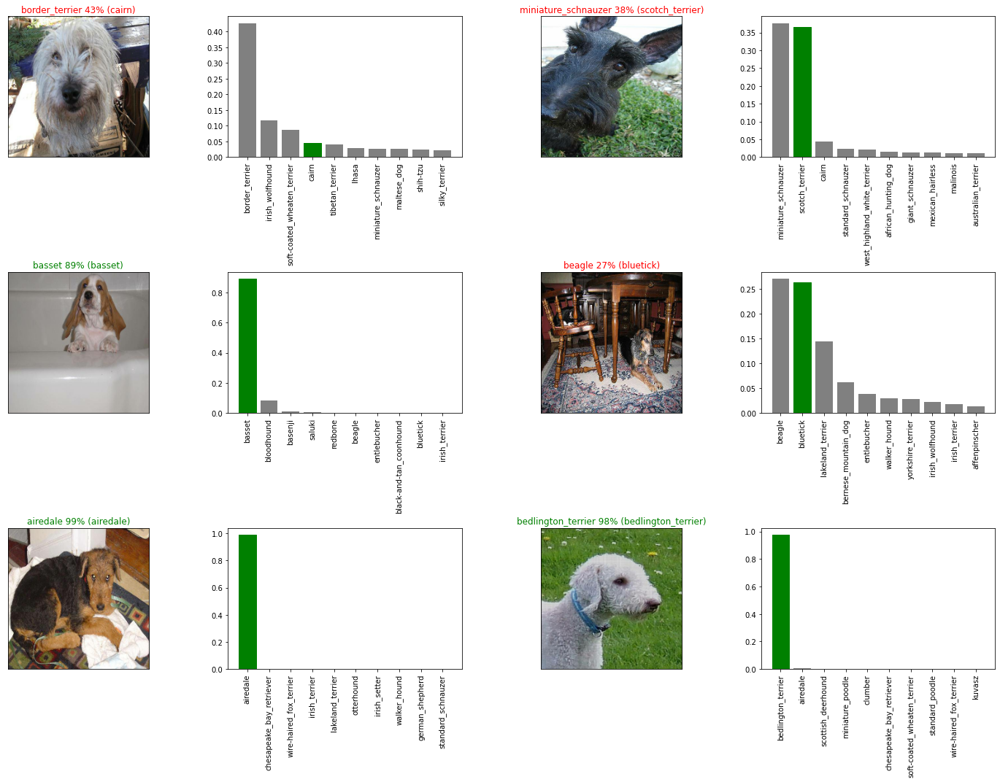

In [155]:

i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

## 5. Saving and loading a model



*Function to save a model*

In [156]:
def save_model(model, suffix=None):

  # Create model directory with current time
  modeldir = os.path.join("/content/drive/MyDrive/DBI Project/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

*Function to load a model*

In [157]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [158]:
# Save our model trained on 1000 images
save_model(model, suffix="1000-images-utm")

Saving model to: /content/drive/MyDrive/DBI Project/models/20220722-12001658491237-1000-images-utm.h5...


'/content/drive/MyDrive/DBI Project/models/20220722-12001658491237-1000-images-utm.h5'

In [159]:
# Load our model trained on 1000 images
model_1000_images = load_model('/content/drive/MyDrive/DBI Project/models/20220721-11321658403159-1000-images-utm.h5')

Loading saved model from: /content/drive/MyDrive/DBI Project/models/20220721-11321658403159-1000-images-utm.h5


*Comparing original and loaded model*

In [160]:
#original
#model.evaluate(val_data)

In [161]:
#loaded
#model_1000_images.evaluate(val_data)

## 6. Training on Full Dataset

In [162]:
full_data = create_data_batches(X, y)

Creating training data batches...


In [163]:
full_model = create_model()

In [164]:
# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [165]:
%tensorboard --logdir "/content/drive/MyDrive/DBI Project/logs"

Reusing TensorBoard on port 6006 (pid 10020), started 0:00:13 ago. (Use '!kill 10020' to kill it.)

<IPython.core.display.Javascript object>

*Full model training*

In [166]:
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 41s 118ms/step - loss: 1.3326 - accuracy: 0.6722
Epoch 2/100
320/320 [==============================] - 40s 126ms/step - loss: 0.4010 - accuracy: 0.8806
Epoch 3/100
320/320 [==============================] - 38s 119ms/step - loss: 0.2404 - accuracy: 0.9356
Epoch 4/100
320/320 [==============================] - 39s 123ms/step - loss: 0.1526 - accuracy: 0.9650
Epoch 5/100
320/320 [==============================] - 44s 136ms/step - loss: 0.1059 - accuracy: 0.9793
Epoch 6/100
320/320 [==============================] - 44s 138ms/step - loss: 0.0774 - accuracy: 0.9872
Epoch 7/100
320/320 [==============================] - 42s 132ms/step - loss: 0.0595 - accuracy: 0.9922
Epoch 8/100
320/320 [==============================] - 42s 132ms/step - loss: 0.0467 - accuracy: 0.9941
Epoch 9/100
320/320 [==============================] - 46s 143ms/step - loss: 0.0376 - accuracy: 0.9953
Epoch 10/100
320/320 [==============================] - 42s 132m

*Save model to file*

In [167]:
save_model(full_model, suffix="all-images-utm")

Saving model to: /content/drive/MyDrive/DBI Project/models/20220722-12221658492525-all-images-utm.h5...


'/content/drive/MyDrive/DBI Project/models/20220722-12221658492525-all-images-utm.h5'

*Load in the full model*

In [173]:
loaded_full_model = load_model('/content/drive/MyDrive/DBI Project/models/20220722-12221658492525-all-images-utm.h5')

Loading saved model from: /content/drive/MyDrive/DBI Project/models/20220722-12221658492525-all-images-utm.h5


*Making Predictions on test dataset*

In [174]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
test_path = "/content/drive/MyDrive/DBI Project/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

['/content/drive/MyDrive/DBI Project/test/de15c21ba0a1f139d26223d5e2b09703.jpg',
 '/content/drive/MyDrive/DBI Project/test/e53b2f4211fb7a34aeaa04974b919f6d.jpg',
 '/content/drive/MyDrive/DBI Project/test/df99a948e43d3399aff2e8ab2c18e184.jpg',
 '/content/drive/MyDrive/DBI Project/test/e596c0d97b381e876d46dda2eb60074c.jpg',
 '/content/drive/MyDrive/DBI Project/test/e12e6997c15c233c7b92209e08ff9d14.jpg',
 '/content/drive/MyDrive/DBI Project/test/e379ba26a5e2e22e85975b839e0e401b.jpg',
 '/content/drive/MyDrive/DBI Project/test/e757a7450559dc61a9261fe978e23b04.jpg',
 '/content/drive/MyDrive/DBI Project/test/e2c3376aeea1057337f02dfc48feee62.jpg',
 '/content/drive/MyDrive/DBI Project/test/e1e6d180a31b0a9c0d741d0f142ea6af.jpg',
 '/content/drive/MyDrive/DBI Project/test/e7ce78e874945f182a4f5149aa505b09.jpg']

In [175]:
len(test_filenames)

10357

In [176]:
test_data = create_data_batches(test_filenames, test_data=True)

Creating test data batches...


In [177]:
test_predictions = loaded_full_model.predict(test_data,
                                             verbose=1)

324/324 [==============================] - 42s 129ms/step


In [178]:
test_predictions[:10]

array([[6.64707818e-14, 1.56631869e-13, 1.39273232e-10, ...,
        4.88402678e-12, 4.19460777e-12, 1.44059435e-11],
       [9.57182142e-13, 9.99999046e-01, 4.03891753e-10, ...,
        2.76465018e-10, 1.67993987e-11, 1.83259330e-09],
       [3.36201822e-09, 6.08527334e-13, 2.52996083e-12, ...,
        2.43590231e-10, 4.49313029e-06, 4.82135276e-10],
       ...,
       [5.77916410e-07, 2.26313884e-10, 2.97569986e-08, ...,
        1.67317857e-08, 7.93468132e-07, 2.20386487e-09],
       [2.97943874e-12, 3.45570378e-11, 1.04890196e-12, ...,
        5.71859449e-10, 2.09398115e-14, 1.43869543e-11],
       [1.29804278e-07, 5.19293775e-11, 1.17943018e-05, ...,
        1.20609434e-09, 5.39136780e-09, 2.30021510e-06]], dtype=float32)

## 7. Using Custom Images

Now to fullfil our original purpose, we will use custom images to predict dogs breed.

*Custom image filepath*

In [188]:
custom_path = "/content/drive/MyDrive/DBI Project/dogs/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

*Test batch creation*

In [189]:
custom_data = create_data_batches(custom_image_paths, test_data=True)

Creating test data batches...


*Making Predictions*

In [190]:
custom_preds = loaded_full_model.predict(custom_data)

*Turning predictions into labels*

In [191]:
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

['golden_retriever', 'golden_retriever']

*Get custom image*

In [192]:
custom_images = []

for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

*Ploting custom images and their predicted labels*

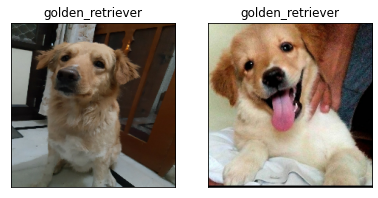

In [193]:
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 3, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)